In [154]:
import os
import re
import time
import spotipy
import librosa
import warnings
import requests
import numpy as np
import pandas as pd
import altair as alt
import seaborn as sns
import umap.umap_ as umap
import plotly.express as px
import matplotlib.pyplot as plt

from tqdm import tqdm
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.cluster import KMeans
from sklearn import model_selection
from sklearn.decomposition import PCA
from sklearn.manifold import MDS, TSNE
from sklearn.dummy import DummyClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from spotipy.oauth2 import SpotifyClientCredentials, SpotifyOAuth
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.neighbors import NeighborhoodComponentsAnalysis, KNeighborsClassifier
from sklearn.metrics import recall_score, precision_score, accuracy_score, classification_report

from scipy.special import comb
from sklearn.manifold import MDS
from sklearn.manifold import TSNE
from sklearn.cluster import Birch
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AffinityPropagation
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from spotipy.oauth2 import SpotifyClientCredentials, SpotifyOAuth

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, plot_confusion_matrix

from IPython.display import Image


warnings.filterwarnings("ignore")

In [7]:
## Functions helping to count how many songs are there in the dataframe for each genre and 
## another one to balance data
def song_count(df):
    grouped_df = df.groupby('song_genre').count().reset_index()
    grouped_df
    totals = list(zip(grouped_df['song_genre'], grouped_df[grouped_df.columns[1]]))
    for genre, count in totals:
        print(genre,count)
    print('Total songs: {}'.format(len(df)))

def balance_data(df):
    grouped_df = df.groupby(['song_genre']).count()
    min_songs = min(grouped_df[grouped_df.columns[0]])
    min_genre = grouped_df[grouped_df.columns[0]][grouped_df[grouped_df.columns[0]] == min_songs].index.tolist()
    return df.groupby('song_genre').head(min_songs)
    

# Scrap songs from different genres

Spotify has an API where the user can gain access to their song repertoir, however, access to all the songs at once nor do big searches an all 35M+ songs that are available in the platform cannot be done.

One of the methods used here to collect information about songs for this project is to use the `recommendations()` method from the API. Recommendations are generated based on the available information for a given seed entity and matched against similar artists and tracks. If there is sufficient information about the provided seeds, a list of tracks will be returned along with pool size details.

Using a seed for a specific genre, scrapping the server was done to collect as many songs as possible. With this approach, it was garaunteed that the songs we are retrieving belong to the genre requested. The genres to analyze here are:

||  |  |
| --- | --- | --- |
| Blues | Classical | Country |
| Electronic | Heavy Metal | Hip Hop |
| Indie | K-pop | Pop |
| Punk | Reggae | Reggaeton |
| Rock | R&B | Salsa |

Data was scrapped from Spotify, there is extensive code that was used for that purpose that it is presentented in the notebook "getting_data_from_spotify" that it is not presented here. Notebook is available for review. In this notebook there are 2 main files containing the music data and they are as follows:

- 1000_songs.csv - 12,850 records, aimed to contain 1000 songs for each genre, however not 1000 songs were available from the Spotify API, in result, not all genres have 1000 songs. This dataset contains attributes solely from the Spotify database.
- 1000_songs_mfcc_plus_other_feats.csv - reduced data set due to not all records have a audio file for further processing.

### Read data into a DataFrame from previously scrapped data

In [8]:
df = pd.read_csv('data/1000_songs.csv').drop(columns=['Unnamed: 0', 'Unnamed: 0.1'])
df.sample(3)

,song_name,song_id,song_genre,url,artist,artist_id,artist_genre,release_date,duration_ms,popularity,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms_,time_signature
12565,Buenaventura y Caney,3IHAPVtrS0oT7IVdrF9REo,salsa,https://open.spotify.com/track/3IHAPVtrS0oT7IV...,Grupo Niche,1zng9JZpblpk48IPceRWs8,"['latin', 'salsa', 'salsa colombiana', 'tropic...",2012-08-16,309893,35,...,-6.355,0,0.0510,0.586000,0.000002,0.0624,0.906,96.178,309893,4
9977,Hey Baby (Drop It to the Floor) (feat. T-Pain),3rfhI32Il2hVRKDkuGeeen,reggaeton,https://open.spotify.com/track/3rfhI32Il2hVRKD...,"['Pitbull', 'T-Pain']","['0TnOYISbd1XYRBk9myaseg', '3aQeKQSyrW4qWr35id...","[['dance pop', 'latin', 'miami hip hop', 'pop'...",2011-06-17,234453,71,...,-3.428,0,0.0884,0.043400,0.000000,0.2590,0.762,128.024,234453,4
7726,Serf,7HJyh0udWaFvTBXWPv4nJm,punk,https://open.spotify.com/track/7HJyh0udWaFvTBX...,KNIFEY,1eaYls632isMO4uoMOESnG,[],2017-09-29,156762,0,...,-2.451,0,0.0677,0.000129,0.002190,0.3250,0.172,154.608,156762,4


One aspect to note in this dataset is that the recommendatios seem to be capped at 1000 songs for some genres and to 500 for the lower side with the classical genre. 

In [9]:
song_count(df)

blues 1000
classical 500
country 950
electronic 1000
heavy-metal 600
hip-hop 950
indie 950
k-pop 650
pop 950
punk 850
r-n-b 900
reggae 599
reggaeton 998
rock 950
salsa 1000
Total songs: 12850


### Audio Features
The audio features that we will be exploring are those provided by Spotify for each song.

These features are mostly measured in a scale of 0-1, for example:

- Danceability: a measurement of how "danceable" a given song is.
- Energy: perceptual measure of intensity and activity.
- Intrumentalness: whether a song contains no vocals (pure intrumental).
- Liveness: presence of audience in a song i.e.: on a concert.
- Loudness: How loud a song is in dB.
- Mode: Minor or Major mode.
- Speechiness: presence of words in a song.
- Tempo: Beats per minute (BPM).


In [10]:
feature_names = ['danceability','energy','key','loudness','mode','speechiness','acousticness',
                'instrumentalness','liveness','valence','tempo', 'duration_ms','time_signature', 'song_genre']

Crosschecking that the retrieved songs match the genre specified by Spotify. Click on the link to listen to the song.

In [11]:
d = df.sample()[['url', 'song_genre', 'artist_genre']]
print(d['url'][d['url'].index[0]])
print(d['song_genre'])
print(d['artist_genre'])

https://open.spotify.com/track/3eqT34f3rxmm4dR7madDIM
7285    pop
Name: song_genre, dtype: object
7285    [['dance pop', 'hip pop', 'pop', 'post-teen po...
Name: artist_genre, dtype: object


# Data Exploration

## Descriptive Statistics

In [12]:
df_feats = df[feature_names]
df_feats.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,12850.000000,1.285000e+04,12850.000000
mean,0.591095,0.678036,5.313930,-7.343142,0.608949,0.091209,0.239980,0.102799,0.191519,0.527995,120.544393,2.435383e+05,3.937510
std,0.177526,0.226651,3.582148,4.514793,0.488005,0.087003,0.289645,0.249886,0.155780,0.256653,30.378698,9.656337e+04,0.352969
min,0.000000,0.000000,0.000000,-43.804000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.056000e+03,0.000000
25%,0.479000,0.545000,2.000000,-8.436500,0.000000,0.038200,0.012525,0.000000,0.092400,0.324000,95.884000,1.981495e+05,4.000000
50%,0.608000,0.720000,6.000000,-6.160500,1.000000,0.054900,0.105000,0.000017,0.129000,0.537000,118.959000,2.276930e+05,4.000000
75%,0.725000,0.856000,8.000000,-4.694000,1.000000,0.104000,0.392750,0.007660,0.254000,0.741750,139.955500,2.686098e+05,4.000000
max,0.976000,1.000000,11.000000,1.342000,1.000000,0.944000,0.996000,0.994000,0.992000,0.991000,220.169000,4.195000e+06,5.000000


## Density plots

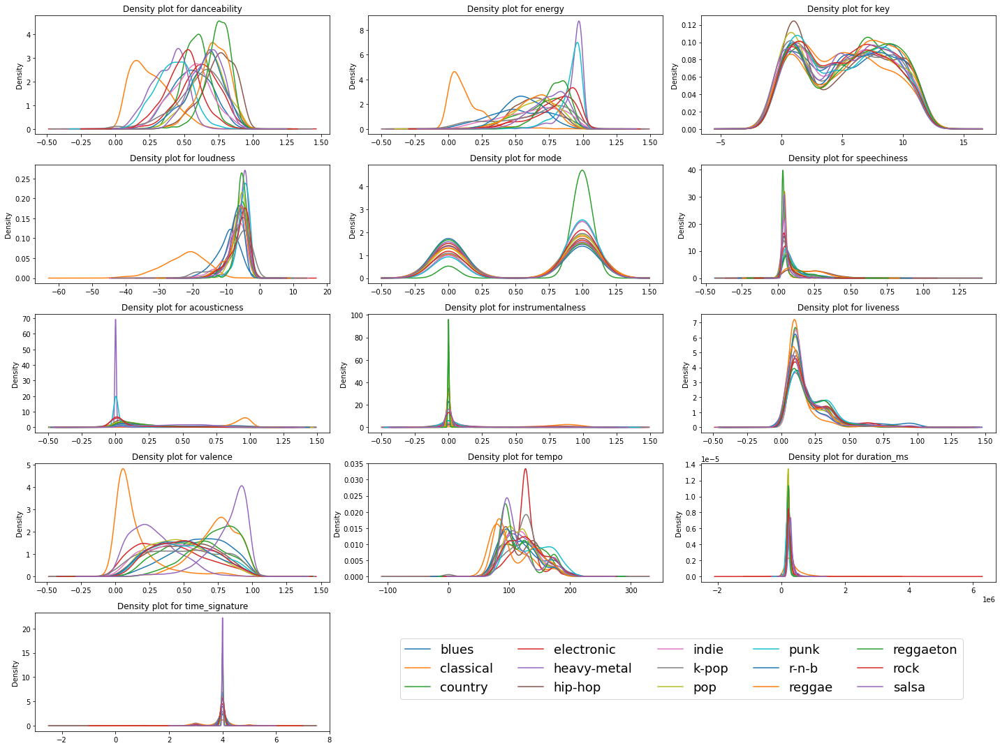

In [13]:
fig = plt.figure(figsize=(20, 15))
for idx,feat in enumerate(feature_names[:-1]):
    ax = fig.add_subplot(5,3,idx+1)
    df_feats.groupby('song_genre')[feat].plot(kind='density', legend=False)
    plt.title('Density plot for {}'.format(feat))

plt.tight_layout()
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=5, fontsize=18, bbox_to_anchor=(0.68, 0.06))
plt.show()

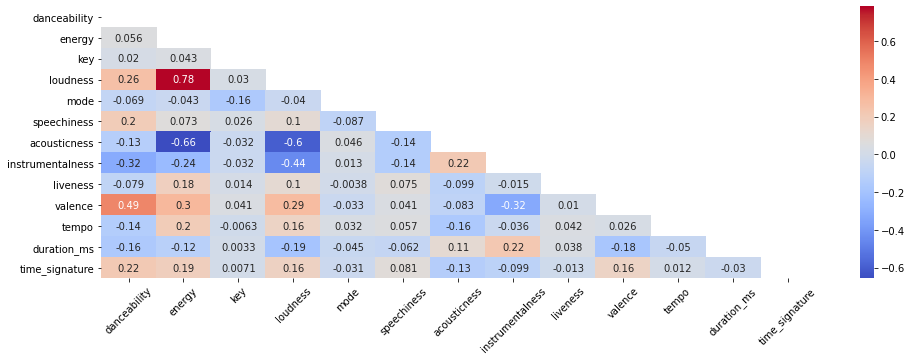

In [14]:
corr = df_feats.corr()
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
corr[mask] = np.nan
(corr
 .style
 .background_gradient(cmap='coolwarm', axis=None, vmin=-1, vmax=1)
 .highlight_null(null_color='#f1f1f1')  # Color NaNs grey
 .set_precision(2))

plt.figure(figsize = (16,5))
ax = sns.heatmap(corr, annot = True, cmap="coolwarm")
plt.xticks(rotation=45)
plt.show()

# Librosa features

Early in the development it was noted that the features from Spotify alone were not enough to predict song genre and then external libraries were used to enhance the features for each song.

Librosa was used in conjuction with the audio files scrapped from Spotify to process them to gather additional features such as: Mel-frequency cepstral coefficients (MFCCs), different types of spectral features such as centroid, contrast, flatness and rolloff, as well as chroma and zero crossing rate.

These features were parsed through the librosa library to extract the features from the audio files. Code for this extractios is done in the notebook "getting_data_from_spotify".

### Exploring Librosa features

In [15]:
df = pd.read_csv('data/1000_songs_mfcc_plus_other_feats.csv').drop(columns=['Unnamed: 0', 'index'])
df.sample(3)

,song_name,song_id,song_genre,url,artist,artist_id,artist_genre,release_date,duration_ms,popularity,...,rolloff,onset,chroma,pitches,magnitudes,spectral_centroid,spectral_flatness,spectral_contrast,poly_features,chroma_cens
4125,Clandestino,7DrluKkTviBwCc8AV3VGmf,pop,https://open.spotify.com/track/7DrluKkTviBwCc8...,"['Shakira', 'Maluma']","['0EmeFodog0BfCgMzAIvKQp', '1r4hJ1h58CWwUQe3Mx...","[['colombian pop', 'dance pop', 'latin', 'lati...",2018-06-08,231920,67,...,5155.271815,2.102861,0.383683,17.576986,0.302598,2368.085515,0.022499,20.756783,3.295940,0.270177
2505,Selfish,2xbI8Vmyv3TkpTdywpPyNw,hip-hop,https://open.spotify.com/track/2xbI8Vmyv3TkpTd...,PnB Rock,21WS9wngs9AqFckK7yYJPM,"['melodic rap', 'pop rap', 'r&b', 'rap', 'sout...",2017-01-13,245604,71,...,5699.709069,1.530913,0.431617,5.733032,0.236488,2463.474800,0.014573,21.494425,3.426346,0.177913
2203,Unbreakable,1IaQLINjiOCSv4INrrv0aS,heavy-metal,https://open.spotify.com/track/1IaQLINjiOCSv4I...,Stratovarius,1O8CSXsPwEqxcoBE360PPO,"['finnish power metal', 'hard rock', 'melodic ...",2013-02-22,277546,51,...,6632.126718,1.104592,0.479770,43.191097,0.509862,3035.241048,0.057886,19.295317,4.415697,0.267594


In [16]:
# Checking song counts after processing new features and dropping rows without mfcc features
song_count(df)

blues 467
classical 380
country 804
electronic 466
heavy-metal 238
hip-hop 826
indie 604
k-pop 74
pop 651
punk 466
r-n-b 766
reggae 260
reggaeton 494
rock 743
salsa 566
Total songs: 7805


In [17]:
# Summary statistics
df.describe()

,duration_ms,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,...,rolloff,onset,chroma,pitches,magnitudes,spectral_centroid,spectral_flatness,spectral_contrast,poly_features,chroma_cens
count,7.805000e+03,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,...,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000
mean,2.447674e+05,48.877386,0.590303,0.672426,5.308008,-7.419537,0.609481,0.091744,0.232428,0.088589,...,5087.586687,1.456563,0.398472,25.841736,0.331253,2409.913944,0.024292,21.085849,3.064735,0.250802
std,9.609520e+04,18.607225,0.178528,0.224933,3.580293,4.718096,0.487898,0.088287,0.280296,0.235142,...,1139.311964,0.331442,0.068218,16.981978,0.159767,515.836189,0.015411,1.451899,1.162364,0.020840
min,5.316800e+04,0.000000,0.000000,0.000049,0.000000,-43.804000,0.000000,0.000000,0.000000,0.000000,...,748.154003,0.482045,0.135671,1.097211,0.001791,502.392857,0.000011,17.055860,0.014690,0.146661
25%,1.991180e+05,37.000000,0.479000,0.543000,2.000000,-8.456000,0.000000,0.037900,0.014900,0.000000,...,4548.431538,1.187331,0.356569,13.805138,0.216403,2132.299215,0.013144,20.087017,2.339160,0.240457
50%,2.277540e+05,51.000000,0.606000,0.712000,6.000000,-6.180000,1.000000,0.054000,0.106000,0.000008,...,5259.792718,1.393112,0.395999,21.905760,0.308995,2474.345082,0.022396,20.961368,3.078010,0.255122
75%,2.689600e+05,63.000000,0.724000,0.848000,8.000000,-4.709000,1.000000,0.105000,0.368000,0.003200,...,5831.886992,1.708163,0.440084,33.100414,0.429554,2748.413935,0.033281,21.857544,3.841682,0.265942
max,2.533813e+06,87.000000,0.973000,0.999000,11.000000,1.342000,1.000000,0.944000,0.996000,0.994000,...,8185.396202,2.671891,0.689060,124.333664,1.219214,4333.557837,0.138018,28.725614,7.841354,0.283414


In [18]:
# All Features
feature_names_mfcc = ['danceability','energy','key','loudness','mode','speechiness','acousticness',
                      'instrumentalness','liveness','valence','tempo', 'duration_ms','time_signature', 
                      'mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8',
                      'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 
                      'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20', 'zcr', 'rolloff', 'onset', 'chroma',
                      'pitches', 'magnitudes', 'spectral_centroid', 'spectral_flatness', 'spectral_contrast',
                      'poly_features', 'chroma_cens', 'song_genre']
feats_df = df[feature_names_mfcc[:-1]]

In [19]:
feats_df.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,...,rolloff,onset,chroma,pitches,magnitudes,spectral_centroid,spectral_flatness,spectral_contrast,poly_features,chroma_cens
count,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,...,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000,7805.000000
mean,0.590303,0.672426,5.308008,-7.419537,0.609481,0.091744,0.232428,0.088589,0.188940,0.520562,...,5087.586687,1.456563,0.398472,25.841736,0.331253,2409.913944,0.024292,21.085849,3.064735,0.250802
std,0.178528,0.224933,3.580293,4.718096,0.487898,0.088287,0.280296,0.235142,0.153536,0.253593,...,1139.311964,0.331442,0.068218,16.981978,0.159767,515.836189,0.015411,1.451899,1.162364,0.020840
min,0.000000,0.000049,0.000000,-43.804000,0.000000,0.000000,0.000000,0.000000,0.010700,0.000000,...,748.154003,0.482045,0.135671,1.097211,0.001791,502.392857,0.000011,17.055860,0.014690,0.146661
25%,0.479000,0.543000,2.000000,-8.456000,0.000000,0.037900,0.014900,0.000000,0.092900,0.320000,...,4548.431538,1.187331,0.356569,13.805138,0.216403,2132.299215,0.013144,20.087017,2.339160,0.240457
50%,0.606000,0.712000,6.000000,-6.180000,1.000000,0.054000,0.106000,0.000008,0.128000,0.527000,...,5259.792718,1.393112,0.395999,21.905760,0.308995,2474.345082,0.022396,20.961368,3.078010,0.255122
75%,0.724000,0.848000,8.000000,-4.709000,1.000000,0.105000,0.368000,0.003200,0.249000,0.727000,...,5831.886992,1.708163,0.440084,33.100414,0.429554,2748.413935,0.033281,21.857544,3.841682,0.265942
max,0.973000,0.999000,11.000000,1.342000,1.000000,0.944000,0.996000,0.994000,0.987000,0.982000,...,8185.396202,2.671891,0.689060,124.333664,1.219214,4333.557837,0.138018,28.725614,7.841354,0.283414


In [20]:
# convert column names into a list
categories=list(feats_df.columns)
# number of categories
N=len(categories)

# create a list with the average of all features
value=list(feats_df.mean())

fig = px.line_polar(feats_df, r=value, theta=categories, line_close=True, range_r=[-20,20])
fig.update_traces(fill='toself')
fig.show()

In [60]:
# fig = sns.pairplot(df[feature_names_mfcc], hue='song_genre')
# fig.savefig('pairplot.png')
Image(filename='pairplot.png')

# Supervised Learning
# Building a classifier to predict a song genre based on song feauteres

### Selecting the features to use as input to the classifier

In [22]:
# All Features
feature_names_mfcc = ['danceability','energy','key','loudness','mode','speechiness','acousticness',
                      'instrumentalness','liveness','valence','tempo', 'duration_ms','time_signature', 
                      'mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8',
                      'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 
                      'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20', 'zcr', 'rolloff', 'onset', 'chroma',
                      'pitches', 'magnitudes', 'spectral_centroid', 'spectral_flatness', 'spectral_contrast',
                      'poly_features', 'chroma_cens', 'song_genre']

In [23]:
# Cherry Pick Features
cp_feature_names_mfcc = ['danceability','energy','loudness','speechiness','acousticness',
                      'instrumentalness','liveness','valence','tempo', 'duration_ms', 
                      'mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8',
                      'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 
                      'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20', 'zcr', 'rolloff', 'onset', 'chroma',
                      'pitches', 'magnitudes', 'spectral_centroid', 'spectral_flatness', 'spectral_contrast',
                      'poly_features', 'chroma_cens', 'song_genre']

### Splitting the data set in training and test as well as scalling the data. K-pop was removed from the dataset due to having less than 100 songs with audio files to analyze.

In [24]:
# Split data in training and test sets
df_data = df[feature_names_mfcc]
#Removing KPop due to very little information
df_data = df_data[df_data['song_genre'] != 'k-pop']
# df_data = balance_data(df_data)
X = df_data.iloc[:, :-1]
y = df_data.iloc[:, -1]

X_train_raw, X_test_raw, y_train, y_test = train_test_split(X, y, random_state=0)

X_train = StandardScaler().fit_transform(X_train_raw)
X_test  = StandardScaler().fit_transform(X_test_raw)

### Create dummy classifier to compare against the trained classifier it can be seen that the output are very low scores

In [25]:
# Dummy classifiers to check against real classifier
dummy_A = DummyClassifier(strategy = 'stratified', random_state = 0).fit(X_train, y_train)
dummy_B = DummyClassifier(strategy = 'most_frequent').fit(X_train, y_train)

y_dummy_A_predictions = dummy_A.predict(X_test)
y_dummy_B_predictions = dummy_B.predict(X_test)

preA = precision_score(y_test, y_dummy_A_predictions, average='micro')
recA = recall_score(y_test, y_dummy_A_predictions, average='micro')
accA = accuracy_score(y_test, y_dummy_A_predictions)

preB = precision_score(y_test, y_dummy_B_predictions, average='micro')
recB = recall_score(y_test, y_dummy_B_predictions, average='micro')
accB = accuracy_score(y_test, y_dummy_B_predictions)

print('Dummy Classifier A Scores (Stratified)')
print('Precision: {}'.format(preA))
print('Recall:    {}'.format(recA))
print('Accuracy:  {}\n'.format(accA))
print('Dummy Classifier B Scores (Most Frequent)')
print('Precision: {}'.format(preB))
print('Recall:    {}'.format(recB))
print('Accuracy:  {}'.format(accB))

Dummy Classifier A Scores (Stratified)
Precision: 0.08742886704604243
Recall:    0.08742886704604243
Accuracy:  0.08742886704604243

Dummy Classifier B Scores (Most Frequent)
Precision: 0.09570615623383343
Recall:    0.09570615623383343
Accuracy:  0.09570615623383343


# Model Selection
### Running a Cross Fold with 6 different classifiers to find out which one performs the best
- Gaussian NB
- Random Forest
- K Nearest Neighbors
- Support Vector Machine
- Gradient Boosting
- XGBoost

In [26]:
models = [('GaussianNB', GaussianNB()), ('RandomForest', RandomForestClassifier()), ('KNN', KNeighborsClassifier()), 
          ('SVM', SVC(probability=True)), ('GradientBoosting', GradientBoostingClassifier()), ('XGB', XGBClassifier(eval_metric='mlogloss'))]
dfs = []
results = []
names = []
scoring = ['accuracy', 'precision_weighted', 'recall_weighted', 'f1_weighted', 'roc_auc_ovr_weighted']
target_names = y.unique().tolist()

for name, model in models:
    kfold = model_selection.KFold(n_splits=5, shuffle=True, random_state=0)
    cv_results = model_selection.cross_validate(model, X_train, y_train.values, cv=kfold, scoring=scoring)
    clf = model.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(name)
    print(classification_report(y_test, y_pred))
    results.append(cv_results)
    names.append(name)
    this_df = pd.DataFrame(cv_results)
    this_df['model'] = name
    dfs.append(this_df)
final = pd.concat(dfs, ignore_index=True)

GaussianNB
              precision    recall  f1-score   support

       blues       0.48      0.45      0.47       133
   classical       0.70      0.90      0.79        89
     country       0.52      0.69      0.59       185
  electronic       0.69      0.45      0.54       122
 heavy-metal       0.43      0.87      0.57        55
     hip-hop       0.64      0.54      0.59       218
       indie       0.29      0.14      0.19       149
         pop       0.36      0.30      0.33       166
        punk       0.39      0.67      0.50       101
       r-n-b       0.51      0.38      0.43       187
      reggae       0.37      0.54      0.44        69
   reggaeton       0.44      0.74      0.55       123
        rock       0.32      0.14      0.19       188
       salsa       0.70      0.76      0.72       148

    accuracy                           0.50      1933
   macro avg       0.49      0.54      0.49      1933
weighted avg       0.49      0.50      0.48      1933

RandomForest
 

In [27]:
bootstraps = []
for model in list(set(final.model.values)):
    model_df = final.loc[final.model == model]
    bootstrap = model_df.sample(n=30, replace=True)
    bootstraps.append(bootstrap)
        
bootstrap_df = pd.concat(bootstraps, ignore_index=True)
results_long = pd.melt(bootstrap_df,id_vars=['model'],var_name='metrics', value_name='values')
time_metrics = ['fit_time','score_time'] # fit time metrics
## PERFORMANCE METRICS
results_long_nofit = results_long.loc[~results_long['metrics'].isin(time_metrics)] # get df without fit data
results_long_nofit = results_long_nofit.sort_values(by='values')
## TIME METRICS
results_long_fit = results_long.loc[results_long['metrics'].isin(time_metrics)] # df with fit data
results_long_fit = results_long_fit.sort_values(by='values')

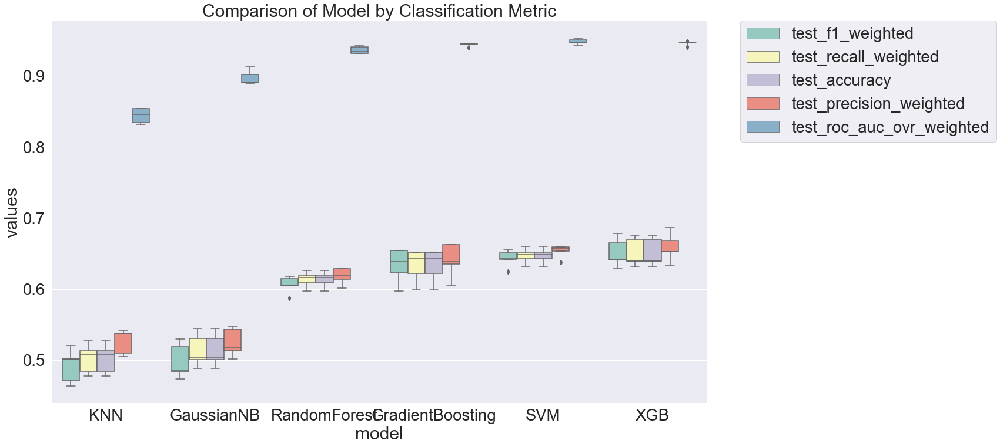

In [28]:
plt.figure(figsize=(20, 12))
sns.set(font_scale=2.5)
g = sns.boxplot(x="model", y="values", hue="metrics", data=results_long_nofit, palette="Set3")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('Comparison of Model by Classification Metric')
plt.savefig('./benchmark_models_performance.png',dpi=300)

## After the results from above, we decided to go with SVM and here are the results from the test set in a confusion matrix

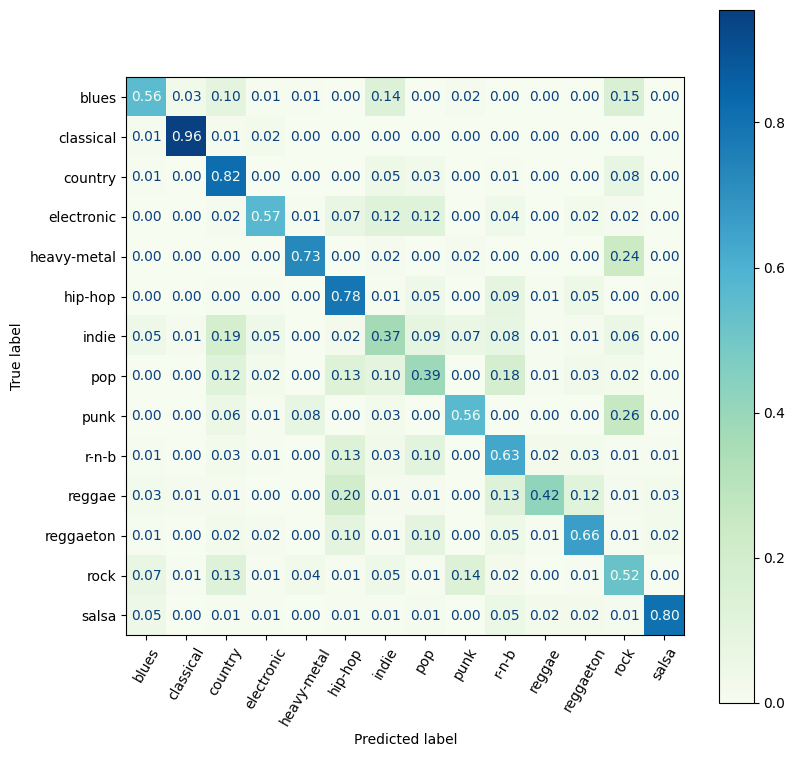

In [181]:
clf = SVC(probability=True).fit(X_train, y_train)
fig, ax = plt.subplots(figsize=(9, 9))
plot_confusion_matrix(clf, X_test, y_test, xticks_rotation=60, ax=ax, normalize='true', values_format='.2f',
                     cmap='GnBu')

## Results from Supervised Portion
### Support Vector Machine

From the results above, Support Vector Machine worked the best for this dataset with an overall score of 0.63. This result might not be impressive but considering that currently the standard is 0.5, an improvement of 0.13 is a considerable result.

Classifying music even is a challenging taks, specially because of the overlap between genres.

As seen in the results, classical music had high performance due to the features for classical are very unique and there is very little overlap with other genres but for music such as rock, country, pop and indie, there is a lot of overlap and for certain songs it is even a very difficult task even for the human.

A follow up task to improve results will be to go through all the songs and have a very well defined boundary for what is a song on each genre but this will potentially provide overfitting.

# Unsupervised

In [95]:
plt.style.use('default')

Let's start analyzing the data by running PCA with the features of interest.

In [108]:
# Scale all features
StdScaler = StandardScaler().fit_transform(df[feature_names_mfcc[:-1]])
# Running PCA on the scaled features
pca = PCA(n_components = 3, random_state = 0).fit(StdScaler)
# Calculating variance for each principal component
singularValues = pca.singular_values_
variance = np.square(singularValues)/(len(StdScaler)-1)
variance

array([11.14447105,  5.75399484,  3.28411238])

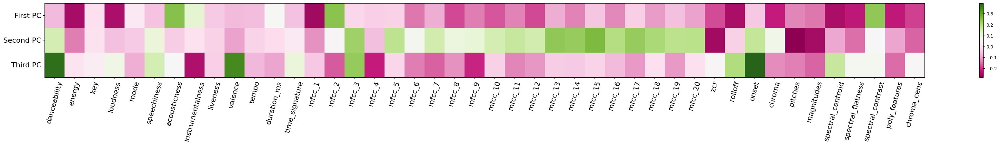

In [97]:
# plot Principal Components to discover what features contain the highest variability
def plot_pca_heatmap(pca, feature_names):
    pc_names = ['First PC', 'Second PC', 'Third PC']
    fig, ax = plt.subplots(figsize=(len(feature_names), 3))
    plt.imshow(pca.components_, interpolation = 'none', cmap = 'PiYG', aspect='auto')
    feature_names=list(feature_names)
    plt.xticks(np.arange(0, len(feature_names), 1) , feature_names[:], rotation = 75, fontsize=16)
    plt.yticks(np.arange(0.0, 3, 1), pc_names, fontsize = 16)
    plt.colorbar()

plot_pca_heatmap(pca, feature_names_mfcc[:-1])

<Figure size 640x480 with 0 Axes>

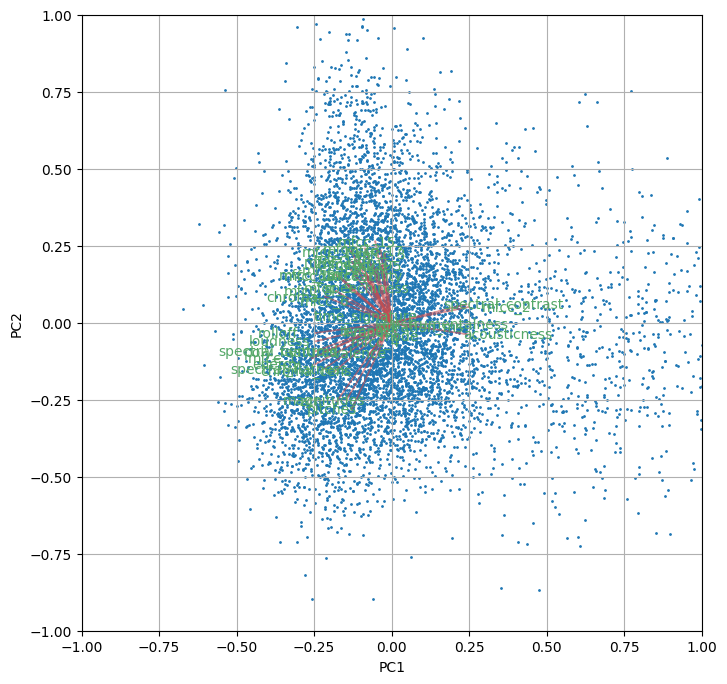

In [120]:
def biplot(score, coeff, maxdim, pcax, pcay, labels=None):
    pca1=pcax-1
    pca2=pcay-1
    xs = score[:,pca1]
    ys = score[:,pca2]
    n = min(coeff.shape[0], maxdim)
    scalex = 2.0/(xs.max()- xs.min())
    scaley = 2.0/(ys.max()- ys.min())
    text_scale_factor = 1.5
    plt.scatter(xs*scalex, ys*scaley, s=1)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,pca1], coeff[i,pca2],color='r',alpha=0.5) 
        if labels is None:
            plt.text(coeff[i,pca1]* text_scale_factor, coeff[i,pca2] * text_scale_factor, "Var"+str(i+1), color='g', ha='center', va='center')
        else:
            plt.text(coeff[i,pca1]* text_scale_factor, coeff[i,pca2], labels[i], color='g', ha='center', va='center')
    plt.xlim(-1,1)
    plt.ylim(-1,1)
    plt.xlabel("PC{}".format(pcax))
    plt.ylabel("PC{}".format(pcay))
    plt.grid()

plt.figure()
plt.figure(figsize=(8, 8))
# plt.show()

X_normalized = StdScaler
X_pca = pca.transform(X_normalized)
biplot(X_pca, np.transpose(pca.components_[0:2, :]), len(feature_names_mfcc), 1, 2, labels=feature_names_mfcc[:-1])


# Scale features and prepare data for clustering models

In [33]:
# Scale features and create new dataframe as input to clustering models
feats_df = df[feature_names_mfcc[:-1]]
feats_df[feature_names_mfcc[:-1]] = StandardScaler().fit_transform(feats_df[feature_names_mfcc[:-1]])
feats_df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,...,rolloff,onset,chroma,pitches,magnitudes,spectral_centroid,spectral_flatness,spectral_contrast,poly_features,chroma_cens
0,-0.035306,-2.500578,-0.644683,-1.084291,0.800462,-0.613318,2.406795,-0.376761,-0.494638,-0.597698,...,-1.693158,-0.392832,-1.649350,-0.769998,-1.281280,-1.491803,-1.388523,1.980250,-1.890299,-0.860404
1,0.300798,-0.602111,-0.924008,0.350066,0.800462,-0.174944,2.128500,-0.376773,1.120721,1.074378,...,-0.471952,-0.372213,-1.313432,0.207792,-0.204361,-0.145213,-0.609335,0.468467,-0.764253,0.456730
2,-1.340509,-1.606920,0.751940,-1.379345,0.800462,-0.648433,0.308878,0.159108,0.808071,-1.181347,...,-0.079551,-0.571698,-0.386291,0.168999,-1.203889,0.170143,-0.565441,0.798959,-1.679710,-1.309428
3,0.020711,0.024784,0.472615,-0.846892,0.800462,-0.589530,0.772703,-0.376140,-0.688090,0.825933,...,-1.307075,-0.788928,-0.093545,0.008957,-0.280912,-1.223677,-1.210231,0.624458,-0.889952,0.519773
4,-1.710223,1.363047,1.589914,1.093210,-1.249278,0.422014,-0.814827,-0.117339,0.508448,-0.779102,...,-0.270266,-0.760870,-1.215994,1.375768,2.032475,0.299427,-0.201487,-0.256929,1.663746,1.215878
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7800,-0.208960,1.154082,1.031264,0.580046,-1.249278,0.342722,0.708482,-0.376773,3.667516,0.597206,...,0.412426,-0.315056,-0.037153,0.367559,1.345161,0.176103,0.242334,-1.147678,1.235372,1.367022
7801,0.384824,0.687246,-0.086034,0.264008,-1.249278,-0.588397,1.461305,-0.376738,1.250992,1.602818,...,0.557970,1.256859,-0.690638,0.179170,-0.451784,0.683402,0.805098,0.768125,-0.941548,-0.229600
7802,-0.959591,-0.793291,-0.365359,0.028305,-1.249278,-0.554415,1.293615,-0.376773,0.345609,-0.897409,...,-0.881684,-0.848948,-0.444626,0.301715,1.482135,-0.756576,-0.756762,-0.077663,0.912107,-0.621917
7803,1.197074,-0.499851,-1.203333,0.107579,-1.249278,-0.589530,0.654963,-0.376773,-0.834644,0.975789,...,1.305071,1.443089,-1.258598,-0.300325,-0.205819,1.300527,0.040965,1.683644,-0.855094,-1.210075


In [113]:
# # This cell will take about an hour to run, run only if need to recompute, otherwise call the dataframe from
# # from a previous run

# # Apply PCA to scaled data and create df
# df_pca = pd.DataFrame(PCA(n_components = 2, random_state = 42).fit_transform(feats_df),columns=['PC1','PC2']) 
# # Apply TSNE to scaled data and create df
# df_tsne = pd.DataFrame(TSNE(n_components = 2, random_state = 42).fit_transform(feats_df),columns=['X','Y']) 
# # Apply MDS to scaled data and create df
# df_mds = pd.DataFrame(MDS(n_components = 2, random_state = 42).fit_transform(feats_df),columns=['X','Y'])
# # Build dataframe with info from all clusters
# df_clusters = pd.DataFrame()
# df_clusters[['PC1', 'PC2']] = df_pca[['PC1', 'PC2']]
# df_clusters[['TSNE_X', 'TSNE_Y']] = df_tsne[['X','Y']]
# df_clusters[['MDS_X', 'MDS_Y']] = df_mds[['X','Y']]
# #Saving df locally
# df_clusters.to_csv('data/df_clusters.csv', index=False)
# Reading from saved file to save time
df_clusters = pd.read_csv('data/df_clusters.csv')
df_clusters.head()

,PC1,PC2,TSNE_X,TSNE_Y,MDS_X,MDS_Y
0,7.803380,-0.810646,65.293840,-0.410227,7.656434,5.616994
1,2.712390,-2.667357,36.603504,-23.469746,1.811598,5.018865
2,2.029683,0.085227,12.354548,-54.022995,8.630966,-3.248115
3,3.784009,-3.442663,38.047115,-19.742760,2.301323,6.737026
4,-2.030602,-2.746619,-44.393787,-25.865543,-6.624378,3.485958


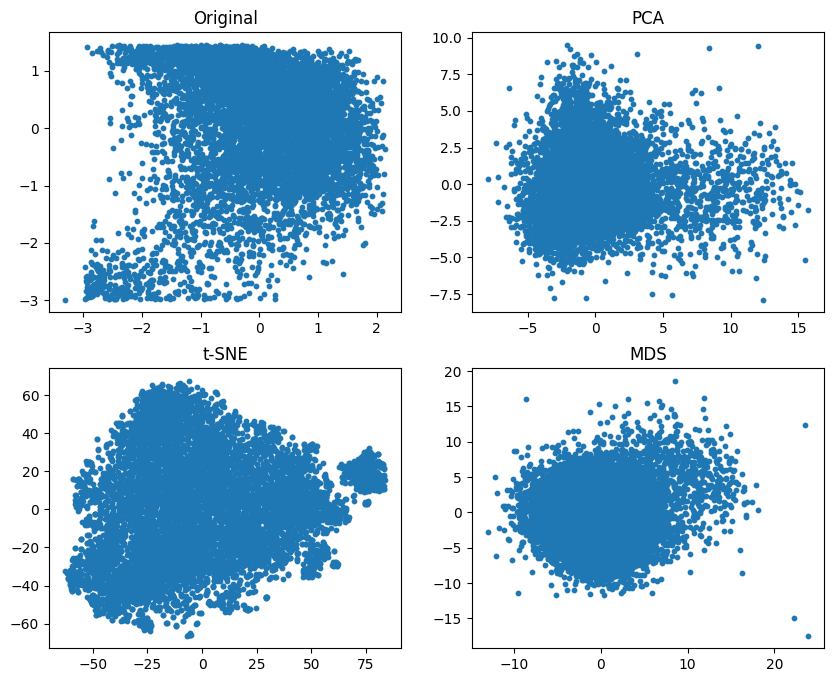

In [114]:
fig, axes = plt.subplots(2, 2, figsize=(10, 8))

axes[0, 0].scatter(StdScaler[:, 0], StdScaler[:, 1], s=10)
axes[0, 1].scatter(df_pca['PC1'], df_pca['PC2'], s=10)
axes[1, 0].scatter(df_tsne['X'], df_tsne['Y'], s=10)
axes[1, 1].scatter(df_mds['X'], df_mds['Y'], s=10)

axes[0, 0].set_title("Original")
axes[0, 1].set_title("PCA")
axes[1, 0].set_title("t-SNE")
axes[1, 1].set_title("MDS")
del fig, axes

# The following cells will show different cluster algorithms on the scaled data itself or on the output from PCA.
# We are going to focus our clustering with 3 main methods: KMeans as a baseline, Birch and Agglomerative.

### First we are going to use the elbow method to find what is the optimal number of clusters (K) to use.
### From the graph below, there is no clear elbow point but probably k=5 might be a good start

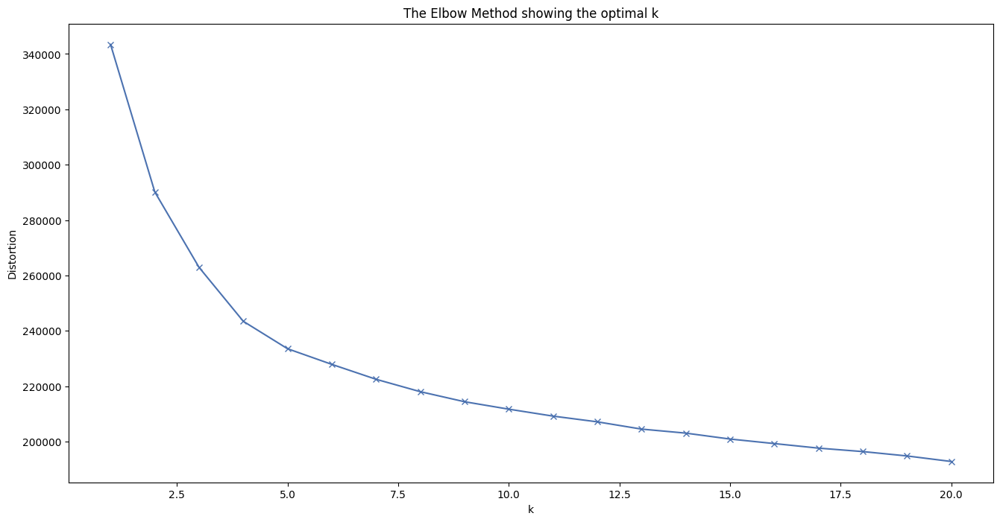

In [66]:
distortions = []
K = range(1,21)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(feats_df)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [67]:
def single_model_and_plot(model, K, df, df_clusters, title, random_state=0):
    try:
        clustering = model(n_clusters=K, random_state=random_state).fit(df)
    except TypeError:
        clustering = model(n_clusters=K).fit(df)
    df_clusters['cluster'] = pd.Categorical(clustering.labels_)
    
    fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(15,10))
    
    gpca = sns.scatterplot(x='PC1', y='PC2', hue='cluster', data=df_clusters, ax=axs[0,0])
    gtsne = sns.scatterplot(x='TSNE_X', y='TSNE_Y', hue='cluster', style='cluster', data=df_clusters, ax=axs[0,1], s=80)
    gmds = sns.scatterplot(x='MDS_X', y='MDS_Y', hue='cluster', style='cluster', data=df_clusters, ax=axs[1,0], s=80)

    gpca.legend(bbox_to_anchor=(1, 1))
    gtsne.legend(bbox_to_anchor=(1, 1))
    gmds.legend(bbox_to_anchor=(1, 1))

    gpca.set_title('PCA')
    gtsne.set_title('T-SNE')
    gmds.set_title('MDS')
    fig.suptitle('{} with {}'.format(title, clustering), fontsize=16)
    plt.show()

### As expected, clustering after PCA is not giving us meaningful clusters due to PCA itslef is not providing any separation in cluster. 
### Clusters seem to be defined enough but the clusters itself are not carrying any similarities between each other. They are following the KMeans algorithm where it is dividing the data equally to find the 15 clusters that was defined as an input.

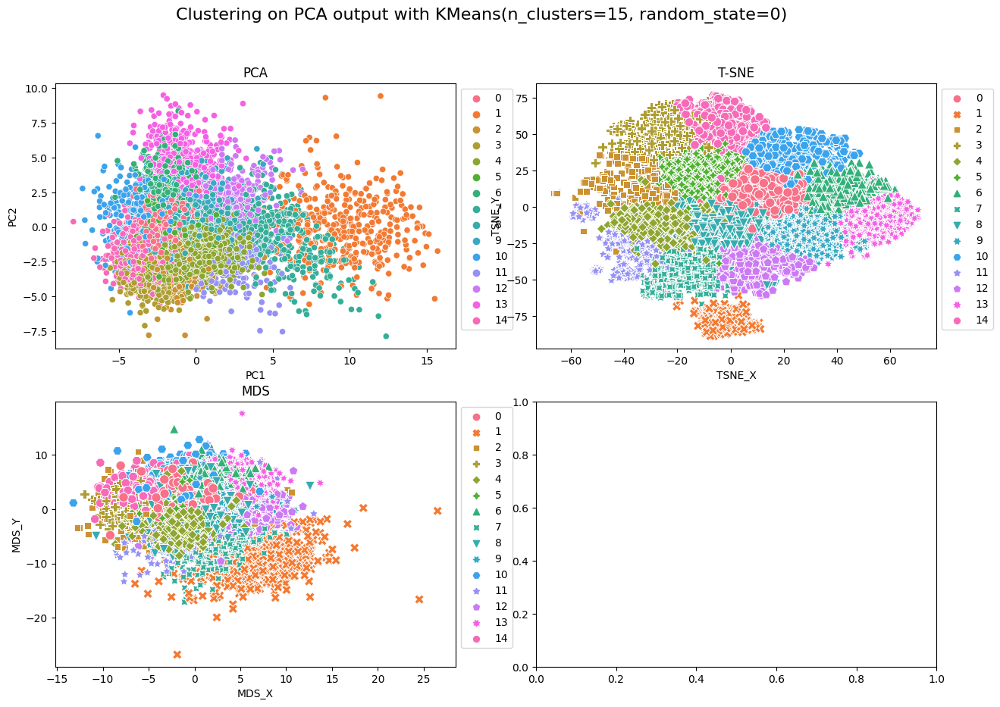

In [68]:
single_model_and_plot(KMeans, K=15, df=X_tsne, df_clusters=df_clusters, title='Clustering on PCA output')

### Clustering with KMeans and then visualizing on PCA shows that the clusters are blury and not well defined plus there are many overlaps, this is not showing a good clustering of our data.

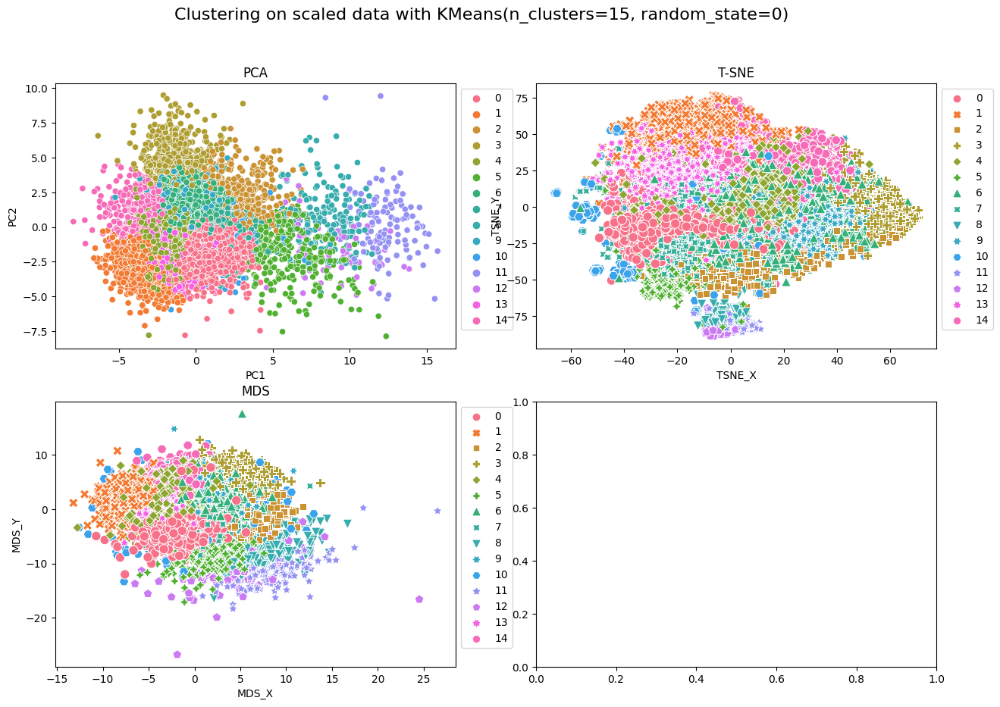

In [69]:
single_model_and_plot(KMeans, K=15, df=feats_df, df_clusters=df_clusters, title='Clustering on scaled data')

### Clustering with KMeans with only those features with highest variability from PCA

### By only using the featues with highest variance from each principal component seem to be losing too much information and bluring even more the clusters

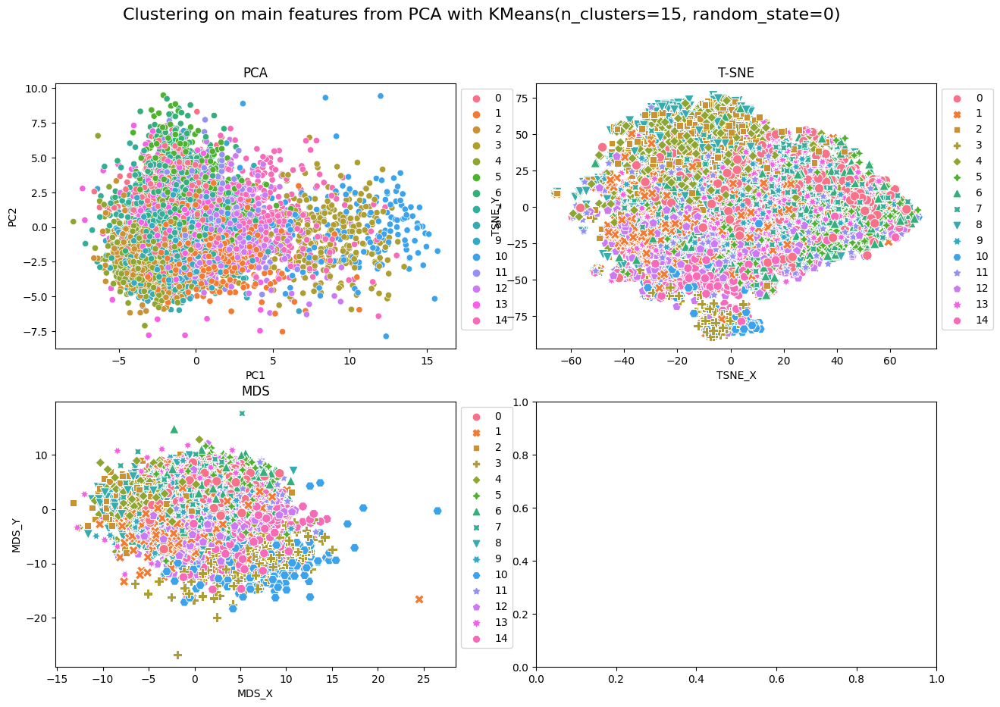

In [70]:
single_model_and_plot(KMeans, K=15, df=feats_df[['acousticness', 'energy', 'danceability', 'mfcc_4', 'mfcc_5', 'key']], 
                      df_clusters=df_clusters, title='Clustering on main features from PCA')

### Using Agglomerative Clustering and then visualizing on T-SNE is showing the best results on the data with more defined clusters.

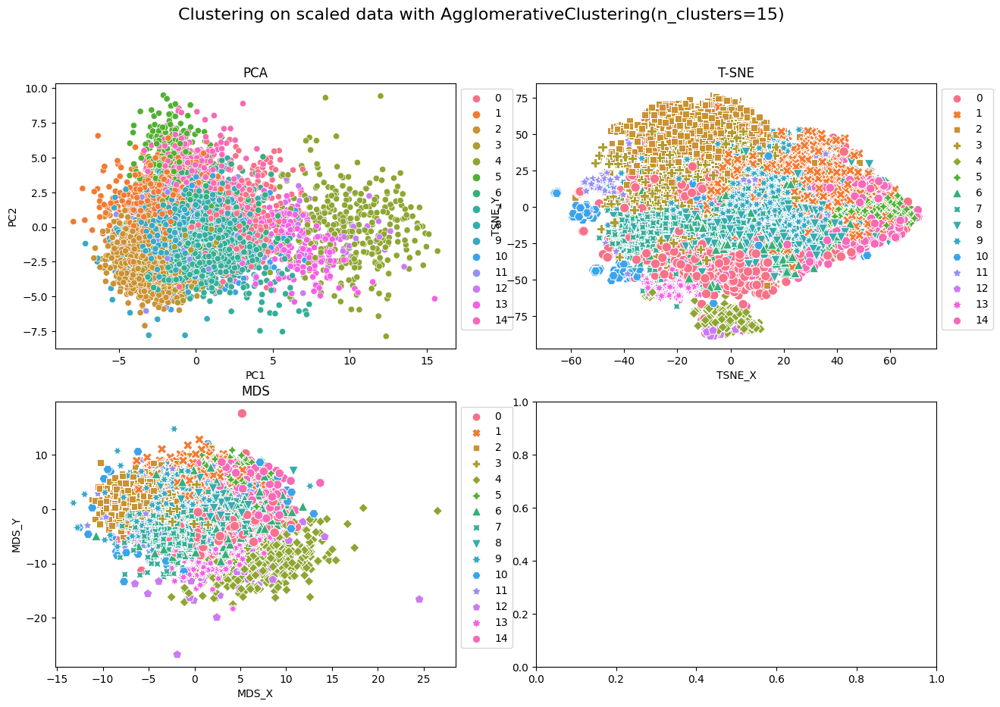

In [71]:
single_model_and_plot(AgglomerativeClustering, K=15, df=feats_df, df_clusters=df_clusters, 
                      title='Clustering on scaled data', random_state=None)

### Birch algorithm is showing similar outputs as Agglomerative Cluster

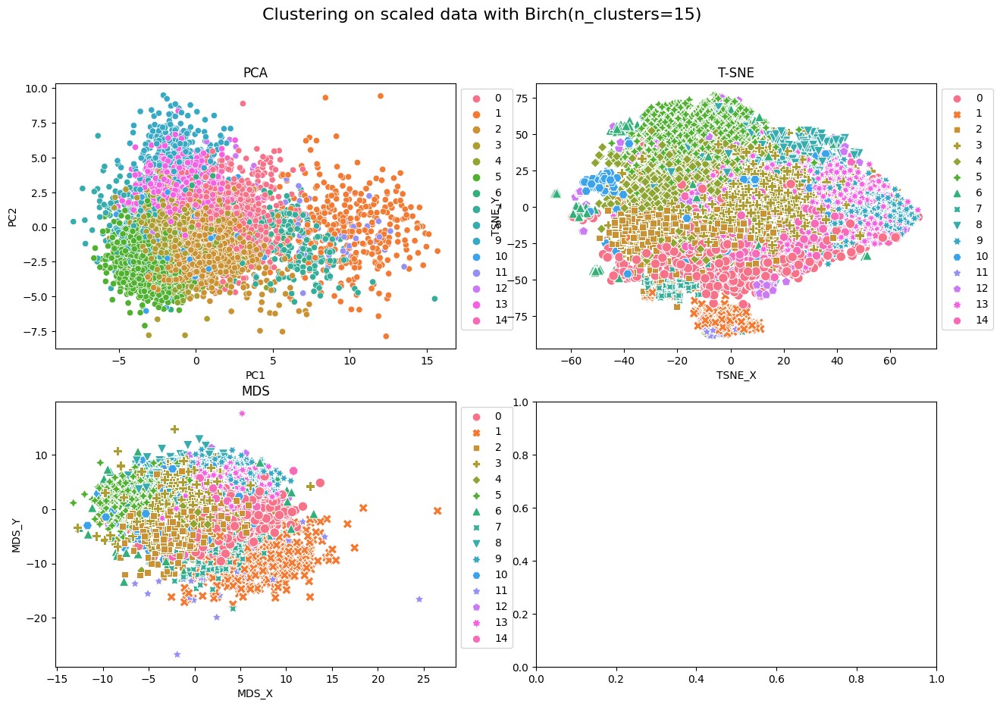

In [72]:
single_model_and_plot(Birch, K=15, df=feats_df, df_clusters=df_clusters, 
                      title='Clustering on scaled data', random_state=None)

# KMeans, Agglomerative Cluster & Birch visualized on T-SNE

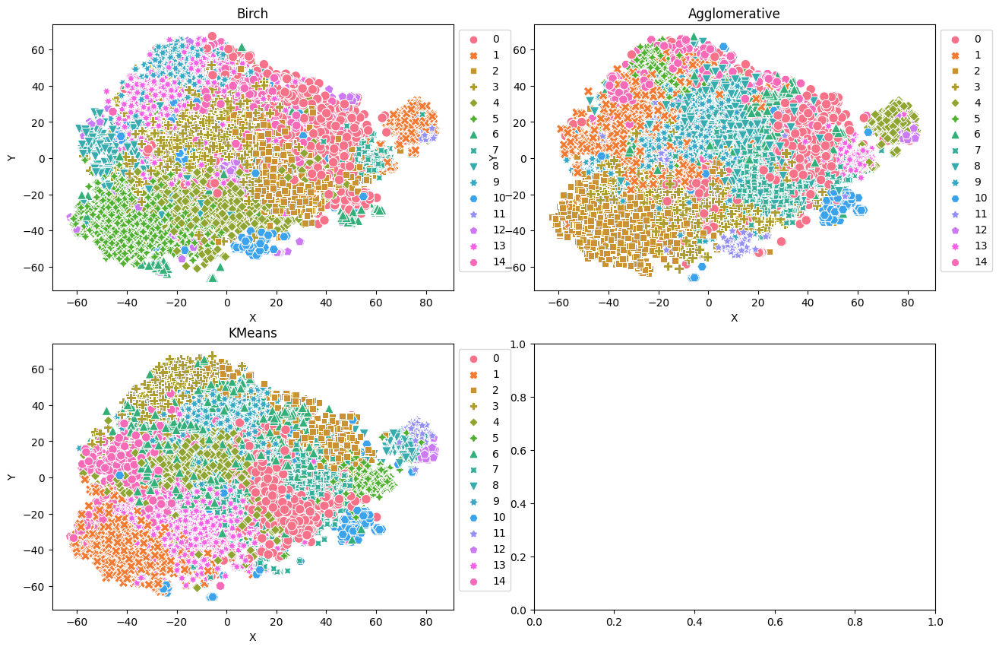

In [121]:
n_clusters = 15
clusteringBirch = Birch(n_clusters=n_clusters).fit(feats_df)
clusteringAgglo = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward').fit(feats_df)
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(feats_df)


df_tsne['clusterBirch'] = pd.Categorical(clusteringBirch.labels_)
df_tsne['clusterAgglo'] = pd.Categorical(clusteringAgglo.labels_)
df_tsne['clusterKmeans'] = pd.Categorical(kmeans.labels_)

fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(15,10))

gpca = sns.scatterplot(x="X", y="Y", hue="clusterBirch", style="clusterBirch", data=df_tsne, ax=axs[0,0], s=80)
gtsne = sns.scatterplot(x="X", y="Y", hue="clusterAgglo", style="clusterAgglo", data=df_tsne, ax=axs[0,1], s=80)
gmds = sns.scatterplot(x="X", y="Y", hue="clusterKmeans", style="clusterKmeans", data=df_tsne, ax=axs[1,0], s=80)

gpca.legend(bbox_to_anchor=(1, 1))
gtsne.legend(bbox_to_anchor=(1, 1))
gmds.legend(bbox_to_anchor=(1, 1))

gpca.set_title('Birch')
gtsne.set_title('Agglomerative')
gmds.set_title('KMeans')

plt.show()

# Score metrics are OK but I think they can be improved, need to work on making the clusters more apart from each other.  how?  Clean the data a little bit more? Get more features from librosa? After adding lyrics?

In [74]:
def CH_DB_Scores(model, df, max_K, title, random_state=0):
    scoreCH = []
    scoreDB = []
    range_n_clusters = list(range(2,max_K+1))
    for n_clusters in range_n_clusters:
        try:
            clustering = model(n_clusters=n_clusters, random_state=random_state).fit(df)
        except TypeError:
            clustering = model(n_clusters=n_clusters).fit(df)
            
        scoreCH.append(calinski_harabasz_score(df, clustering.labels_))
        scoreDB.append(davies_bouldin_score(df, clustering.labels_))
        
    df = pd.DataFrame({'scoreCH':scoreCH, 'scoreDB':scoreDB, 'k':range_n_clusters})
    
    fig, axs = plt.subplots(ncols=2, figsize=(15,5))
    
    gch = sns.lineplot(x='k', y='scoreCH', data=df, ax=axs[0],marker="o").set_title('Calinski-Harabasz Score')
    gdb = sns.lineplot(x='k', y='scoreDB', data=df, ax=axs[1],marker="o").set_title('Davies-Bouldin Score')
    fig.suptitle('{} with {}'.format(title, clustering), fontsize=16)
    plt.show()
    
        

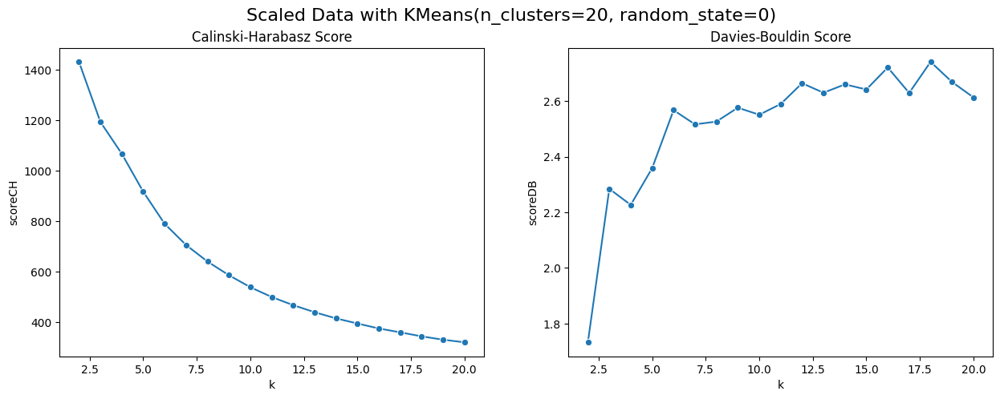

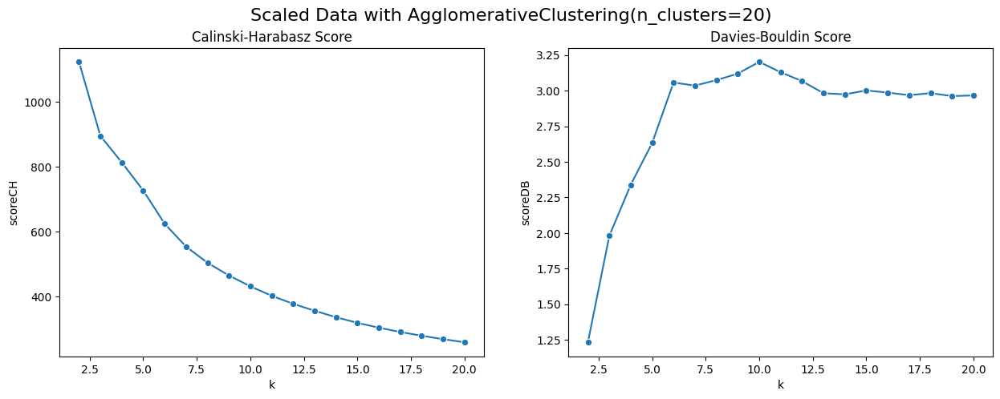

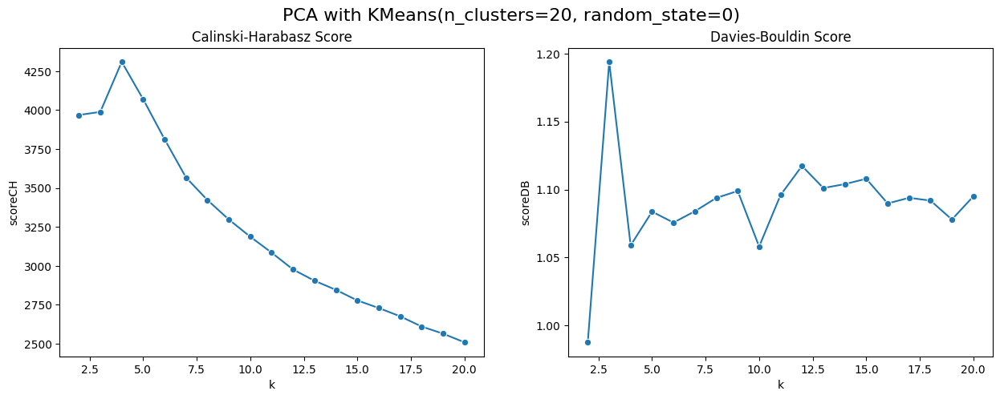

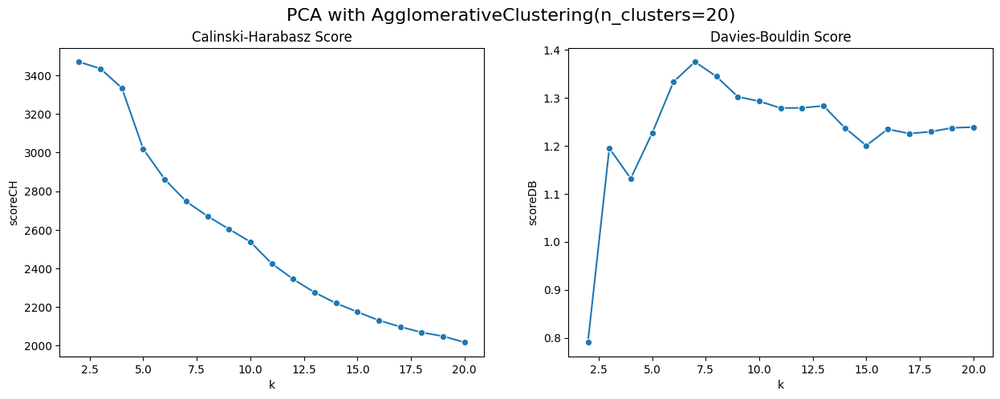

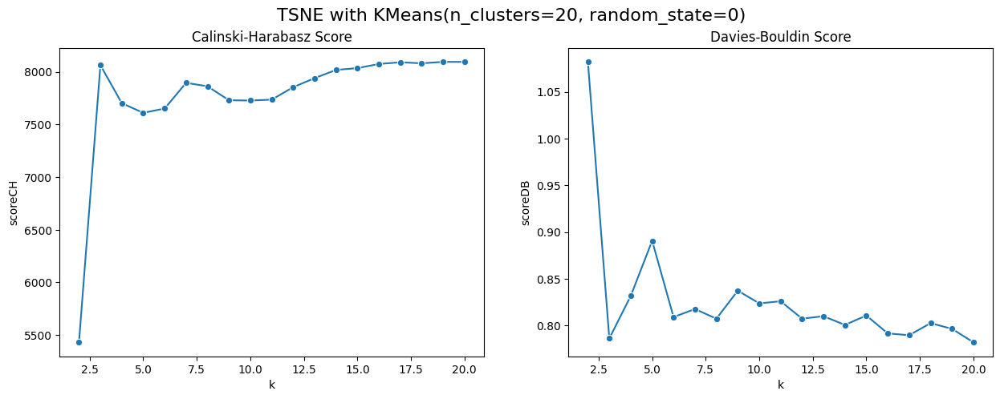

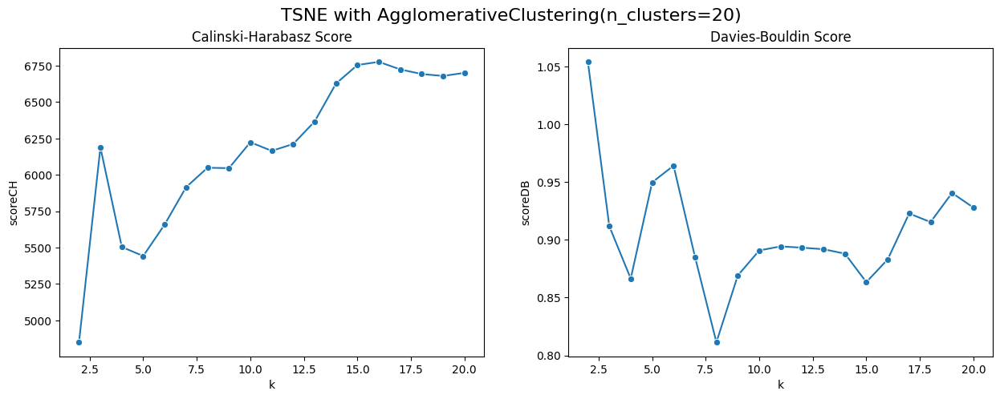

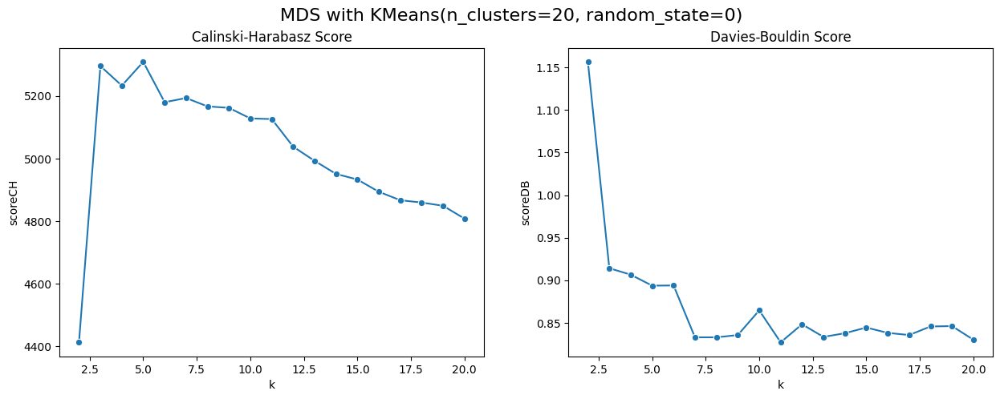

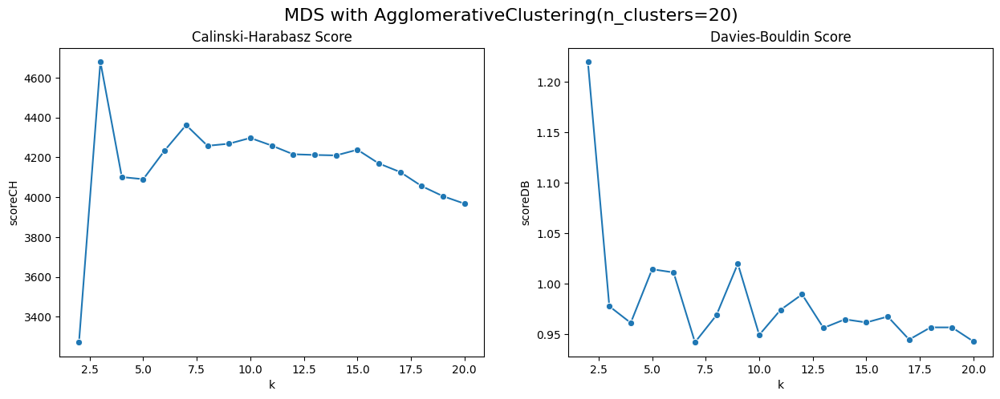

In [75]:
# data = [df,X_pca,X_tsne,X_mds]
data = [(feats_df,'Scaled Data'), (X_pca,'PCA'), (X_tsne,'TSNE'), (X_mds,'MDS')]
for d,t in data:
    CH_DB_Scores(KMeans, d, max_K=20, title=t)
    CH_DB_Scores(AgglomerativeClustering, d, max_K=20, title=t)

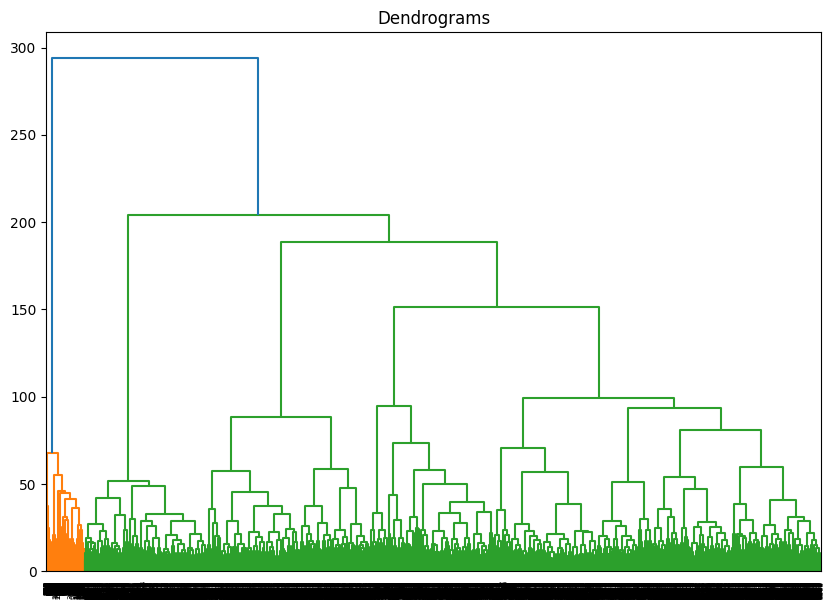

In [76]:
import scipy.cluster.hierarchy as shc
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms")  
dend = shc.dendrogram(shc.linkage(feats_df, method='ward'))